In [15]:
import pandas as pd 
from sklearn.cluster import KMeans
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn import metrics
import matplotlib.pyplot as plt
import seaborn as sns


import math

In [16]:
df = pd.read_csv("sample_orig_2020.csv", sep="|", header=None, usecols=[0,5,7,8,9,10,12,16], names=['CreditScore', 'InsurancePercentage', 'Occupancy', 'LTV', 'DebtToIncome', 'MortgageValue', 'InterestRate', 'PropertyState']) 

In [17]:
print(df.describe())

        CreditScore  InsurancePercentage           LTV  DebtToIncome  \
count  25000.000000         25000.000000  25000.000000   25000.00000   
mean     756.590560             5.556360     71.836520      33.78228   
std       71.999272            10.701426     16.719426      11.47428   
min      601.000000             0.000000      7.000000       1.00000   
25%      729.000000             0.000000     61.000000      26.00000   
50%      765.000000             0.000000     75.000000      35.00000   
75%      790.000000             0.000000     80.000000      42.00000   
max     9999.000000            35.000000    104.000000     999.00000   

       MortgageValue  InterestRate  
count   2.500000e+04  25000.000000  
mean    2.775571e+05      3.477088  
std     1.374680e+05      0.491951  
min     2.200000e+04      2.250000  
25%     1.740000e+05      3.125000  
50%     2.540000e+05      3.375000  
75%     3.600000e+05      3.750000  
max     1.280000e+06      6.375000  


In [18]:
#Removing outliers
df = df[df["CreditScore"]<=1000]
df = df[df["DebtToIncome"]<=100]

In [19]:
df.head()

,CreditScore,InsurancePercentage,Occupancy,LTV,DebtToIncome,MortgageValue,InterestRate,PropertyState
0,695,12,P,85,34,460000,3.875,CA
1,781,0,P,67,44,142000,3.250,MI
2,682,0,P,62,43,136000,4.000,WY
3,811,12,P,88,27,138000,3.125,NE
4,754,0,P,80,25,252000,3.750,IL


In [20]:
lim_df = df[['CreditScore', 'InsurancePercentage', 'LTV', 'DebtToIncome', 'MortgageValue', 'InterestRate']]

In [21]:
lim_df.head()

,CreditScore,InsurancePercentage,LTV,DebtToIncome,MortgageValue,InterestRate
0,695,12,85,34,460000,3.875
1,781,0,67,44,142000,3.250
2,682,0,62,43,136000,4.000
3,811,12,88,27,138000,3.125
4,754,0,80,25,252000,3.750


In [22]:
# Replace the categorical values with the numeric equivalents that we have above
categoricalFeatures = ['Occupancy', 'PropertyState']

# Iterate through the list of categorical features and one hot encode them.
for feature in categoricalFeatures:
    onehot = pd.get_dummies(df[feature], prefix=feature)
    data = df.drop(feature, axis=1)
    data = df.join(onehot)

In [23]:
df.CreditScore.max()

831

<AxesSubplot:>

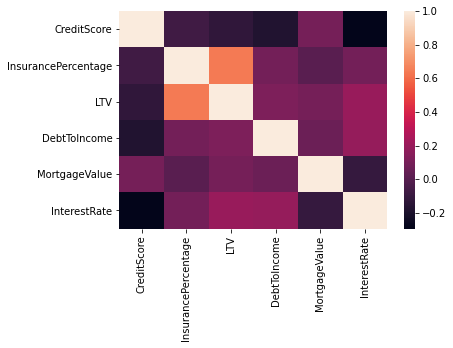

In [24]:
sns.heatmap(lim_df.corr())


In [25]:
import plotly.express as px

fig = px.scatter_matrix(lim_df, dimensions=['CreditScore', 'InsurancePercentage', 'LTV', 'DebtToIncome', 'MortgageValue', 'InterestRate'], labels={col:col.replace('_', ' ') for col in lim_df.columns}, height=900, color="CreditScore", color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()

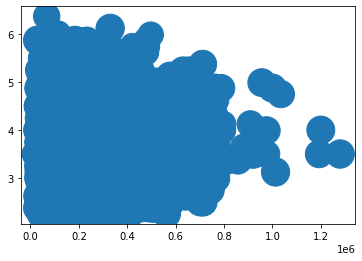

In [26]:
plt.scatter(df.MortgageValue, df.InterestRate, s=df.CreditScore)

<AxesSubplot:>

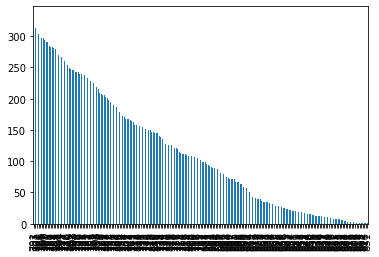

In [27]:
lim_df['CreditScore'].value_counts().plot(kind='bar')


In [28]:
lim_df.shape
lim_df.head

<bound method NDFrame.head of        CreditScore  InsurancePercentage  LTV  DebtToIncome  MortgageValue  \
0              695                   12   85            34         460000   
1              781                    0   67            44         142000   
2              682                    0   62            43         136000   
3              811                   12   88            27         138000   
4              754                    0   80            25         252000   
...            ...                  ...  ...           ...            ...   
24995          703                    0   80            42         676000   
24996          778                    0   72            28         292000   
24997          795                    0   30            43         267000   
24998          740                    0   53            28         200000   
24999          704                    0   23            50         510000   

       InterestRate  
0             3.875  
1

In [40]:
from sklearn.decomposition import PCA 
from sklearn.cluster import KMeans
pca = PCA(3)
projected = pca.fit_transform(lim_df)
print(lim_df.shape)
print(projected.shape)

(24998, 6)
(24998, 3)


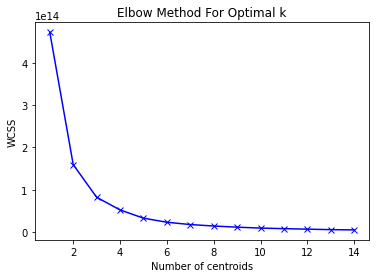

In [41]:

wcss = []
K = range(1,15)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(lim_df)
    wcss.append(km.inertia_)
plt.plot(K, wcss, 'bx-')
plt.xlabel('Number of centroids')
plt.ylabel('WCSS')
plt.title('Elbow Method For Optimal k')
plt.show()

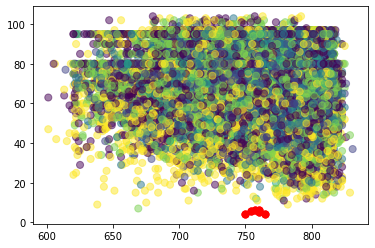

In [53]:
#converting our projected array to pandas df
#pca=pd.DataFrame(lim_df)
#pca.columns=['First component','Second Component']
#build our algorithm with k=3, train it on pca and make predictions
kmeans = KMeans(n_clusters=6, random_state=0).fit(lim_df)
y_kmeans = kmeans.predict(lim_df)
#plotting the results 
plt.scatter(lim_df['CreditScore'], lim_df['LTV'], c=y_kmeans, s=50, alpha=0.5,cmap='viridis')
centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=50)
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=50)

In [55]:
lim_df['cluster'] = y_kmeans
lim_df.head(60)

<ipython-input-55-754d33aa288f>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,CreditScore,InsurancePercentage,LTV,DebtToIncome,MortgageValue,InterestRate,cluster
0,695,12,85,34,460000,3.875,1
1,781,0,67,44,142000,3.250,5
2,682,0,62,43,136000,4.000,5
3,811,12,88,27,138000,3.125,5
4,754,0,80,25,252000,3.750,4
5,763,0,52,20,134000,2.875,5
6,780,0,80,28,230000,4.000,0
7,742,0,41,26,155000,3.125,0
8,787,25,95,17,71000,3.000,5
9,708,25,90,45,63000,4.375,5


In [15]:
df['AssetBins'] =  pd.qcut(lim_df['CreditScore'], 4)
df[['CreditScore', 'AssetBins']].head() 

,CreditScore,AssetBins
0,695,"(600.999, 729.0]"
1,781,"(765.0, 790.0]"
2,682,"(600.999, 729.0]"
3,811,"(790.0, 831.0]"
4,754,"(729.0, 765.0]"


In [16]:
df['AssetBins'] =  pd.qcut(lim_df['CreditScore'], 4)
df[['CreditScore', 'AssetBins']].head() 

,CreditScore,AssetBins
0,695,"(600.999, 729.0]"
1,781,"(765.0, 790.0]"
2,682,"(600.999, 729.0]"
3,811,"(790.0, 831.0]"
4,754,"(729.0, 765.0]"


In [17]:
df['DebtToIncomeBins'] =  pd.qcut(lim_df['DebtToIncome'], 4)
df[['DebtToIncome', 'DebtToIncomeBins']].head() 

,DebtToIncome,DebtToIncomeBins
0,34,"(26.25, 35.0]"
1,44,"(42.0, 50.0]"
2,43,"(42.0, 50.0]"
3,27,"(26.25, 35.0]"
4,25,"(0.999, 26.25]"


In [18]:
df['LTVBins'] =  pd.qcut(lim_df['LTV'], 4)
df[['LTV', 'LTVBins']].head() 

,LTV,LTVBins
0,85,"(80.0, 104.0]"
1,67,"(61.0, 75.0]"
2,62,"(61.0, 75.0]"
3,88,"(80.0, 104.0]"
4,80,"(75.0, 80.0]"


In [70]:
for i in range(6):
    print(lim_df.loc[lim_df['cluster'] == i, 'MortgageValue'].sum())

1214364000
1424502000
1628841000
531733000
1601895000
536914000


,CreditScore,InsurancePercentage,LTV,DebtToIncome,MortgageValue,InterestRate,cluster
6,780,0,80,28,230000,4.000,0
7,742,0,41,26,155000,3.125,0
15,769,30,92,50,189000,3.750,0
23,696,0,80,39,204000,4.000,0
27,783,0,80,22,222000,3.000,0
...,...,...,...,...,...,...,...
24982,781,0,80,35,232000,3.125,0
24987,807,0,55,16,182000,2.875,0
24988,702,0,80,32,194000,3.000,0
24989,754,0,80,28,161000,3.375,0


In [1]:
from credit_risk import CreditRisk


In [7]:
mortgages = [[0.15, 0.1, 100000],
            [0.25, 0.05, 200000],
            [0.03, 0.01, 700000]]


# Confidence level for VaR and CVaR. On BaselII around 99,9%
alpha = 0.03
cr = CreditRisk()


ibmqfactory.load_account:WARNING:2021-04-14 20:05:02,750: Credentials are already in use. The existing account in the session will be replaced.


In [8]:
cr.run(alpha, mortgages, noise=True)

NameError: name 'provider' is not defined

In [12]:
wa = cr.get_weighted_adder()

In [13]:
wa.num_sum_qubits

4

In [15]:
len(cr.loans)

3

In [10]:
cr.loans

[]